In [40]:
import os, sys

%load_ext autoreload

%autoreload 2

PYTHON_PATHS = [ '../','/home/alena/repos/ros-bag-processing']
for path in PYTHON_PATHS:
    if path not in sys.path:
        sys.path.append(path)

import cv2
import numpy as np
import matplotlib.pyplot as plt

from extraction.orb import orb_feature_exctraction
from matching.fundamental_matrix import extract_kp_coords

from matching.fundamental_matrix import plot_good_matches, find_good_matches, apply_model_filtering

from ros_bag_processing.enlighting.hist_norm import HistNormModel
from ros_bag_processing.enlighting.gamma import GammaModel
from ros_bag_processing.enlighting.enlighten_gan import EnlightenGanModel
import utils

from tqdm import tqdm

# !pip uninstall -y onnxruntime
# !pip install onnxruntime-gpu
# try:
#     from enlighten_inference import EnlightenOnnxModel as EnlightenGanModel
# except:
#     print("Error")
#     sys.exit()
import onnxruntime as rt
rt.get_device()

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


'GPU'

In [2]:
fx = 609.824
fy = 614.837
cx = 326.547
cy = 232.0163

In [3]:
fx, fy = (609.824, 614.837)
cx, cy = (326.547, 232.0163)
camera_matrix = np.array([[fx, 0, cx], [0, fy, cy], [0, 0, 1]])

In [4]:
camera_matrix

array([[609.824 ,   0.    , 326.547 ],
       [  0.    , 614.837 , 232.0163],
       [  0.    ,   0.    ,   1.    ]])

In [5]:
img1 = cv2.imread("../tests/hist1.png", 0)
img2 = cv2.imread("../tests/hist2.png", 0)

In [6]:
orb_img1, kp1, des1 = orb_feature_exctraction(img1)
orb_img2, kp2, des2 = orb_feature_exctraction(img2)

# cv2.correctMatches()
init_pt1 = extract_kp_coords(kp1)
init_pt2 = extract_kp_coords(kp2)

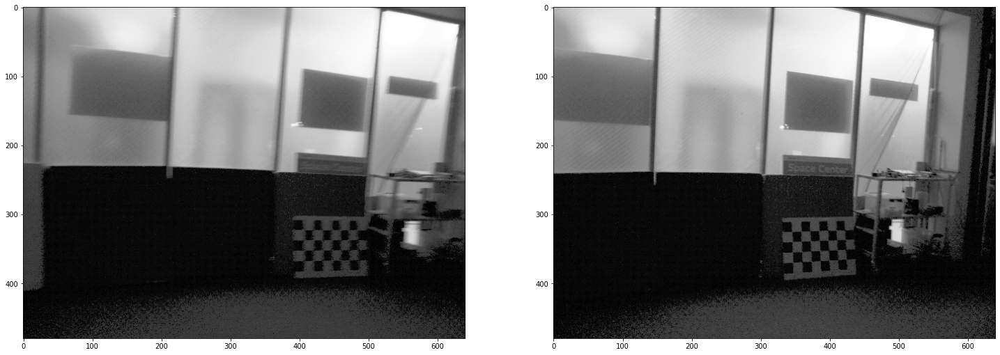

In [7]:
fig, ax = plt.subplots(figsize=(25, 25), ncols=2)
ax[0].imshow(img1, cmap="gray")
ax[1].imshow(img2, cmap="gray")

In [23]:
len(kp1)

1560

In [39]:
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
matches = bf.match(des1, des2)
pts1 = []
pts2 = []

for m in matches:
    pts2.append(kp2[m.trainIdx].pt)
    pts1.append(kp1[m.queryIdx].pt)

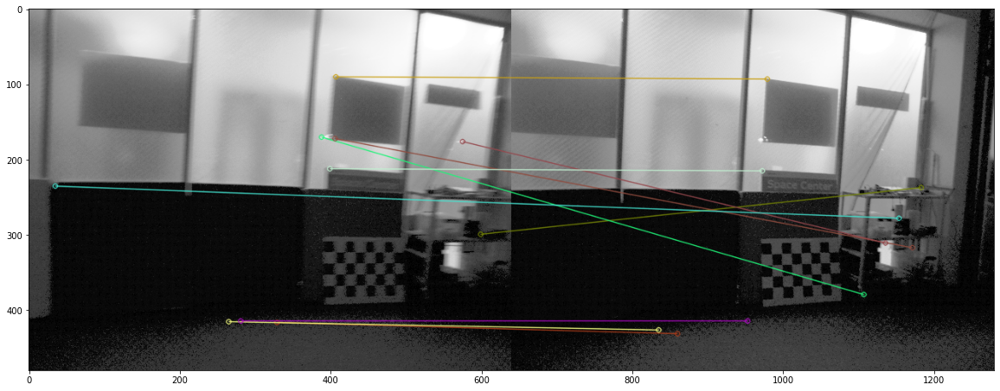

(<matplotlib.image.AxesImage at 0x7fe9d860beb8>, None)

In [40]:
fig, ax = plt.subplots(figsize=(20, 10))
res = cv2.drawMatches(img1,kp1,img2,kp2,matches[:10],None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
plt.imshow(res),plt.show()

In [25]:
len(pts1)

1011

In [43]:
pts1 = np.int32(pts1)
pts2 = np.int32(pts2)
# F, mask= cv2.findFundamentalMat(pts1, pts2, cv2.FM_LMEDS)
F, mask= cv2.findEssentialMat(pts1, pts2) #, camera_matrix, cv2.FM_RANSAC)

In [27]:
sum(mask)

array([227], dtype=uint8)

In [28]:
mask.shape

(1011, 1)

In [29]:
pts1.shape

(1011, 2)

In [30]:
len(matches)

1011

In [31]:
def drawlines(img1,img2,lines,pts1,pts2):
    ''' img1 - image on which we draw the epilines for the points in img2
        lines - corresponding epilines '''
    r,c = img1.shape
    img1 = cv2.cvtColor(img1,cv2.COLOR_GRAY2BGR)
    img2 = cv2.cvtColor(img2,cv2.COLOR_GRAY2BGR)
    for r,pt1,pt2 in zip(lines,pts1,pts2):
        color = tuple(np.random.randint(0,255,3).tolist())
        x0,y0 = map(int, [0, -r[2]/r[1] ])
        x1,y1 = map(int, [c, -(r[2]+r[0]*c)/r[1] ])
        img1 = cv2.line(img1, (x0,y0), (x1,y1), color,1)
        img1 = cv2.circle(img1,tuple(pt1),5,color,-1)
        img2 = cv2.circle(img2,tuple(pt2),5,color,-1)
    return img1,img2

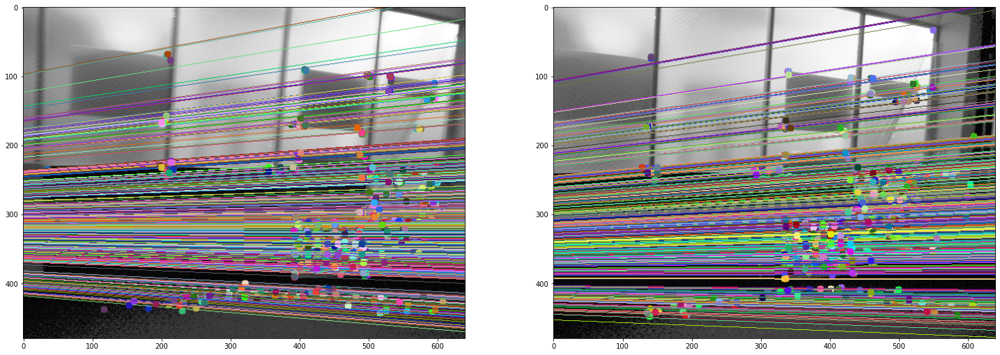

In [32]:
plt.subplots(figsize=(25, 25))
lines1 = cv2.computeCorrespondEpilines(pts2.reshape(-1,1,2), 2,F)
lines1 = lines1.reshape(-1,3)
img5,img6 = drawlines(img1,img2,lines1,pts1,pts2)
# Find epilines corresponding to points in left image (first image) and
# drawing its lines on right image
lines2 = cv2.computeCorrespondEpilines(pts1.reshape(-1,1,2), 1,F)
lines2 = lines2.reshape(-1,3)
img3,img4 = drawlines(img2,img1,lines2,pts2,pts1)
plt.subplot(121),plt.imshow(img5)
plt.subplot(122),plt.imshow(img3)
plt.show()

In [44]:

npt1, npt2 = cv2.correctMatches(F, pts1.reshape(1, pts1.shape[0], pts1.shape[1]), pts2.reshape(1, pts2.shape[0], pts2.shape[1]))

In [54]:
print(npt1[0][0],  pts1[0])

[407  87] [407  90]


(-0.5, 1279.5, 479.5, -0.5)

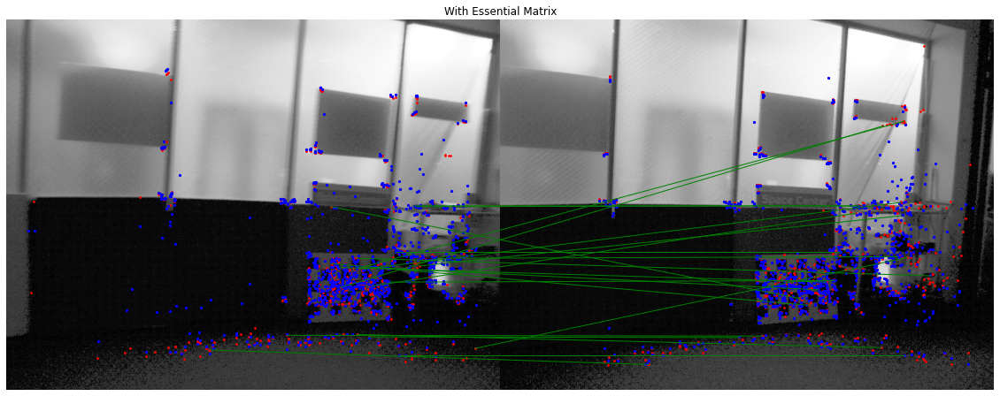

In [56]:
output_image = np.concatenate([img1, img2], axis=1)

fig, ax = plt.subplots(figsize=(20, 20))

ax.imshow(output_image, cmap = "gray")
ax.scatter(pts1[:, 0], pts1[:, 1], s=3, color='r')
ax.scatter(npt1[0, :, 0], npt1[0, :, 1], s=5, color='b')

ax.scatter(pts2[:, 0] + 640, pts2[:, 1], s=3, color='r')
ax.scatter(npt2[0, :, 0]+640, npt2[0, :, 1], s=5, color='b')



i = 0
for points in matches[20:100]:
    if mask[i, 0]:
        color = "green" if mask[i, 0] else "red"
        ax.plot([init_pt1[int(points.queryIdx), 0], init_pt2[int(points.trainIdx), 0] + 640],
                 [init_pt1[int(points.queryIdx), 1], init_pt2[int(points.trainIdx), 1]], linewidth=1,
                 c=color)
    i = i + 1
    # print(i)
ax.set_title("With Essential Matrix")
ax.axis('off')

In [58]:
pts1 = np.int32(pts1)
pts2 = np.int32(pts2)
F, mask= cv2.findFundamentalMat(pts1, pts2, cv2.FM_LMEDS)

In [59]:
sum(mask)

array([208], dtype=uint8)

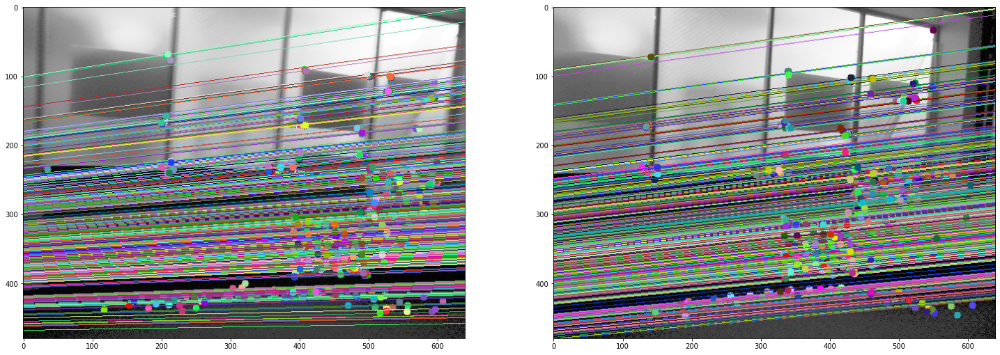

In [60]:
plt.subplots(figsize=(25, 25))
lines1 = cv2.computeCorrespondEpilines(pts2.reshape(-1,1,2), 2,F)
lines1 = lines1.reshape(-1,3)
img5,img6 = drawlines(img1,img2,lines1,pts1,pts2)
# Find epilines corresponding to points in left image (first image) and
# drawing its lines on right image
lines2 = cv2.computeCorrespondEpilines(pts1.reshape(-1,1,2), 1,F)
lines2 = lines2.reshape(-1,3)
img3,img4 = drawlines(img2,img1,lines2,pts2,pts1)
plt.subplot(121),plt.imshow(img5)
plt.subplot(122),plt.imshow(img3)
plt.show()

NameError: name 'matches' is not defined

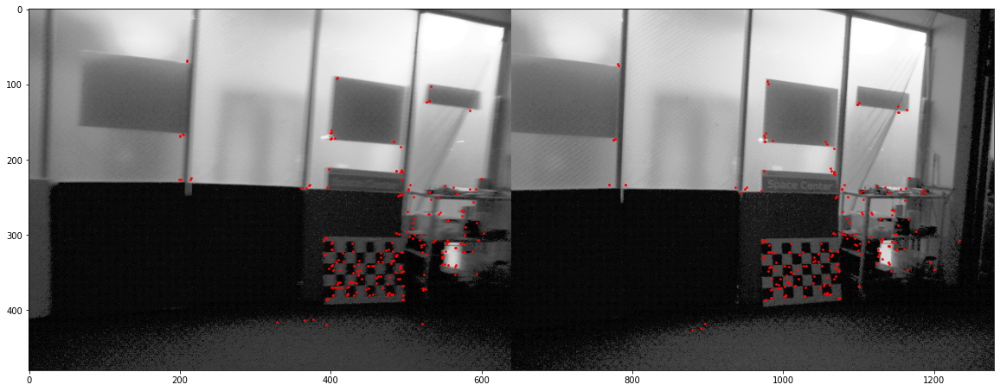

In [12]:
output_image = np.concatenate([img1, img2], axis=1)

fig, ax = plt.subplots(figsize=(20, 20))

ax.imshow(output_image, cmap = "gray")
ax.scatter(pts1[:, 0], pts1[:, 1], s=3, color='r')
# ax.scatter(npt1[:, 0], npt1[0, :, 1], s=5, color='b')

ax.scatter(pts2[:, 0] + 640, pts2[:, 1], s=3, color='r')
# ax.scatter(npt2[0, :, 0]+640, npt2[0, :, 1], s=5, color='b')



i = 0
for points in matches[20:100]:
    if mask[i, 0]:
        color = "green" if mask[i, 0] else "red"
        ax.plot([init_pt1[int(points.queryIdx), 0], init_pt2[int(points.trainIdx), 0] + 640],
                 [init_pt1[int(points.queryIdx), 1], init_pt2[int(points.trainIdx), 1]], linewidth=1,
                 c=color)
    i = i + 1
    # print(i)
ax.set_title("With Fundamental Matrix")
ax.axis('off')

## ORB matches using Homography

In [41]:
fx, fy = (609.824, 614.837)
cx, cy = (326.547, 232.0163)
camera_matrix = np.array([[fx, 0, cx], [0, fy, cy], [0, 0, 1]])

In [42]:
img1 = cv2.imread("../tests/hist1.png", 0)
img2 = cv2.imread("../tests/hist2.png", 0)

In [43]:
orb_img1, kp1, des1 = orb_feature_exctraction(img1)
orb_img2, kp2, des2 = orb_feature_exctraction(img2)

# cv2.correctMatches()
init_pt1 = extract_kp_coords(kp1)
init_pt2 = extract_kp_coords(kp2)

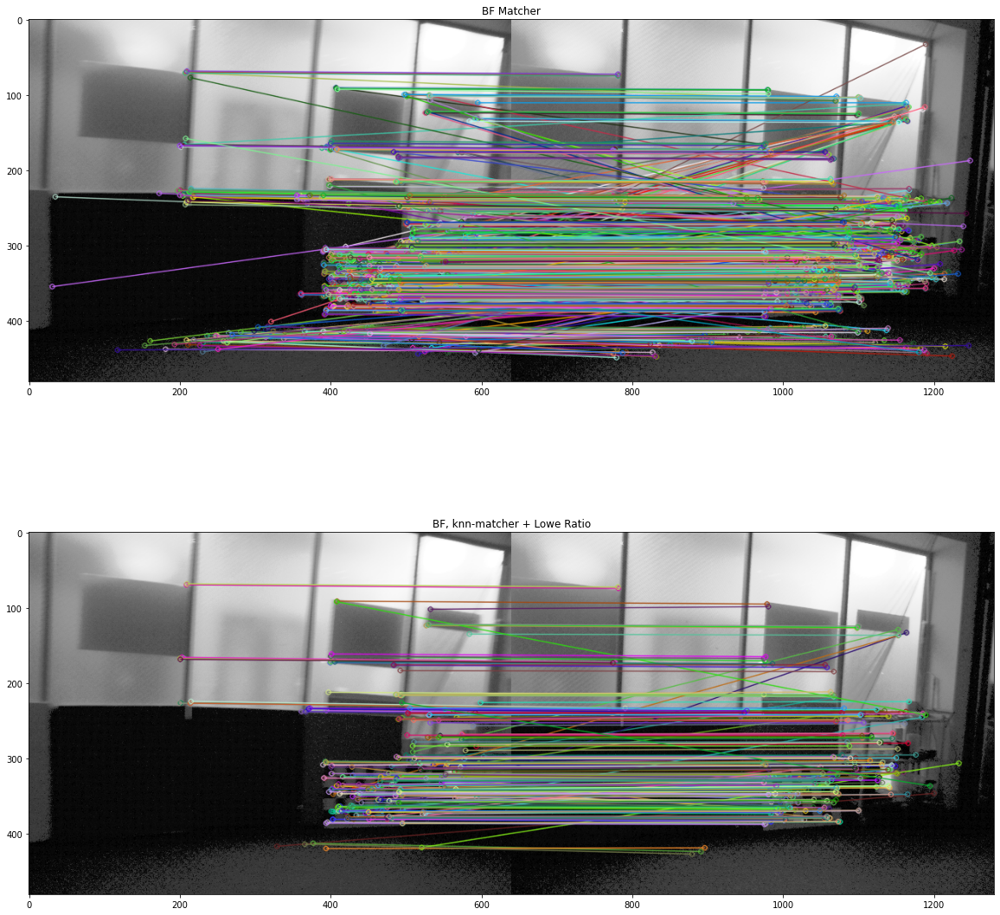

In [44]:
####### BF MATCHER
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
matches_bf  = bf.match(des1, des2)

good_bf = []
for m in matches_bf:
    good_bf.append([m])

##### KNN BF MATCHER
bf = cv2.BFMatcher()
matches_knn = bf.knnMatch(des1, des2,k=2)
# Apply ratio test
good_knn = []
for m,n in matches_knn:
    if m.distance < 0.8*n.distance:
        good_knn.append([m])

### PLOT RESULTS
fig, ax = plt.subplots(figsize=(20, 20), nrows=2)
# BF matcher
img_bf = cv2.drawMatchesKnn(img1,kp1,img2,kp2,good_bf,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
ax[0].set_title("BF Matcher")
ax[0].imshow(img_bf)

# BF-KNN matcher
img_knn = cv2.drawMatchesKnn(img1,kp1,img2,kp2,good_knn,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
ax[1].set_title("BF, knn-matcher + Lowe Ratio")
ax[1].imshow(img_knn)

In [60]:
len(good_knn)

232

In [61]:
pts1 = []
pts2 = []

for m in good_knn:
    pts2.append(kp2[m[0].trainIdx].pt)
    pts1.append(kp1[m[0].queryIdx].pt)
pts1 = np.array(pts1)
pts2 = np.array(pts2)

In [62]:
good_homography_knn = get_good_matches(good_knn, kp1, kp2, method="homo")
good_fm_knn = get_good_matches(good_knn, kp1, kp2, method="fm")
good_em_knn = get_good_matches(good_knn, kp1, kp2, method="em")
good_em_calib_knn = get_good_matches(good_knn, kp1, kp2, method="em_calib")

In [63]:
good_homography_bf = get_good_matches(good_bf, kp1, kp2, method="homo")
good_fm_bf = get_good_matches(good_bf, kp1, kp2, method="fm")
good_em_bf = get_good_matches(good_bf, kp1, kp2, method="em")
good_em_calib_bf = get_good_matches(good_bf, kp1, kp2, method="em_calib")

In [19]:
H, mask_h = cv2.findHomography(pts1, pts2)
print(sum(mask_h == 1))

[232]


In [20]:
good_homography = []
for i, m in enumerate(mask_h):
    if m == 1:
        good_homography.append(good_knn[i])
print(len(good_homography))

232


In [21]:
F, mask_em = cv2.findEssentialMat(pts1, pts2) #, camera_matrix, cv2.FM_RANSAC)
print(sum(mask_em == 1))

[140]


In [22]:
good_essen_matrix = []
for i, m in enumerate(mask_em):
    if m == 1:
        good_essen_matrix.append(good_knn[i])
print(len(good_essen_matrix))

140


In [23]:
F, mask_emc = cv2.findEssentialMat(pts1, pts2, camera_matrix, cv2.FM_RANSAC)
print(sum(mask_emc == 1))

[146]


In [24]:
good_essen_matrix_c = []
for i, m in enumerate(mask_emc):
    if m == 1:
        good_essen_matrix_c.append(good_knn[i])
print(len(good_essen_matrix))

140


In [25]:
F, mask_fm = cv2.findFundamentalMat(pts1, pts2, cv2.FM_RANSAC)
print(sum(mask_fm == 1))

[166]


In [26]:
good_fund_matrix = []
for i, m in enumerate(mask_fm):
    if m == 1:
        good_fund_matrix.append(good_knn[i])
print(len(good_fund_matrix))

166


In [27]:
good_all = []
for i in range(mask_fm.shape[0]):
    if mask_em[i] == 1 or mask_fm[i] == 1:
        good_all.append(good_knn[i])
print(len(good_all))

174


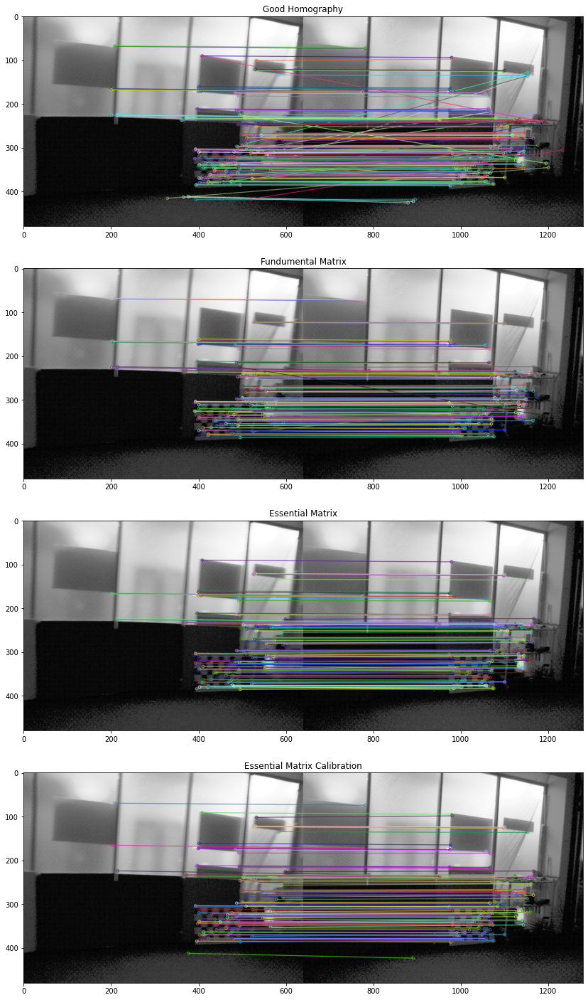

In [31]:
### PLOT RESULTS

fig, ax = plt.subplots(figsize=(25,25), nrows=4)
# Homography
img_homo = cv2.drawMatchesKnn(img1, kp1, img2, kp2, good_homography, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
ax[0].set_title("Good Homography")
ax[0].imshow(img_homo)

# EM
img_em = cv2.drawMatchesKnn(img1, kp1, img2, kp2, good_fund_matrix, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
ax[1].set_title("Fundumental Matrix")
ax[1].imshow(img_em)

# FM
img_em = cv2.drawMatchesKnn(img1, kp1, img2, kp2, good_essen_matrix, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
ax[2].set_title("Essential Matrix")
ax[2].imshow(img_em)

# EM w/ot calibration
img_fm = cv2.drawMatchesKnn(img1, kp1, img2, kp2, good_essen_matrix_c, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
ax[3].set_title("Essential Matrix Calibration")
ax[3].imshow(img_fm)

# # # All
# img_all = cv2.drawMatchesKnn(img1,kp1,img2,kp2,good_all,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
# ax[3].set_title("ALL")
# ax[3].imshow(img_all)

In [73]:
def get_points(keypoints1, keypoints2, good_matches):
    pts1 = []
    pts2 = []

    for m in good_matches:
        pts2.append(keypoints2[m[0].trainIdx].pt)
        pts1.append(keypoints1[m[0].queryIdx].pt)
    pts1 = np.array(pts1)
    pts2 = np.array(pts2)
    return pts1, pts2


def get_good_matches(good_matches, kp1, kp2, method='fm'):
    points1, points2 = get_points(kp1, kp2, good_matches)
    mask = apply_model_filtering(method, points1, points2)
    total = []
    for i, m in enumerate(mask):
        if m == 1:
            total.append(good_matches[i])
    return total

In [74]:
good_homography_knn = get_good_matches(good_knn, kp1, kp2, method="homo")
good_fm_knn = get_good_matches(good_knn, kp1, kp2, method="fm")
good_em_knn = get_good_matches(good_knn, kp1, kp2, method="em")
good_em_calib_knn = get_good_matches(good_knn, kp1, kp2, method="em_calib")

In [75]:
good_homography_bf = get_good_matches(good_bf, kp1, kp2, method="homo")
good_fm_bf = get_good_matches(good_bf, kp1, kp2, method="fm")
good_em_bf = get_good_matches(good_bf, kp1, kp2, method="em")
good_em_calib_bf = get_good_matches(good_bf, kp1, kp2, method="em_calib")

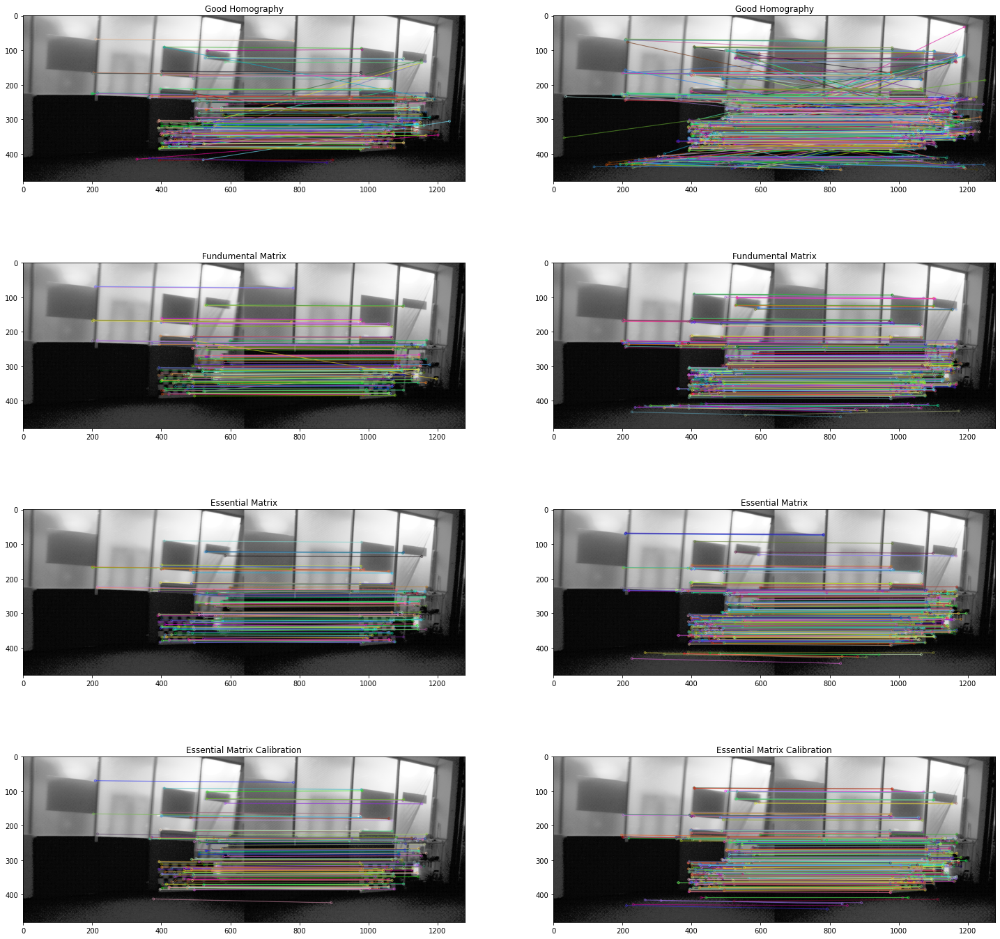

In [76]:
fig, ax = plt.subplots(figsize=(25,25), nrows=4, ncols=2)

i=0
# Homography
img_homo = cv2.drawMatchesKnn(img1, kp1, img2, kp2, good_homography_knn, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
ax[0, i].set_title("Good Homography")
ax[0, i].imshow(img_homo)

# EM
img_em = cv2.drawMatchesKnn(img1, kp1, img2, kp2, good_fm_knn, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
ax[1, i].set_title("Fundumental Matrix")
ax[1, i].imshow(img_em)

# FM
img_em = cv2.drawMatchesKnn(img1, kp1, img2, kp2, good_em_knn, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
ax[2, i].set_title("Essential Matrix")
ax[2, i].imshow(img_em)

# EM w/ot calibration
img_fm = cv2.drawMatchesKnn(img1, kp1, img2, kp2, good_em_calib_knn, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
ax[3, i].set_title("Essential Matrix Calibration")
ax[3, i].imshow(img_fm)


i=1
# Homography
img_homo = cv2.drawMatchesKnn(img1, kp1, img2, kp2, good_homography_bf, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
ax[0, i].set_title("Good Homography")
ax[0, i].imshow(img_homo)

# EM
img_em = cv2.drawMatchesKnn(img1, kp1, img2, kp2, good_fm_bf, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
ax[1, i].set_title("Fundumental Matrix")
ax[1, i].imshow(img_em)

# FM
img_em = cv2.drawMatchesKnn(img1, kp1, img2, kp2, good_em_bf, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
ax[2, i].set_title("Essential Matrix")
ax[2, i].imshow(img_em)

# EM w/ot calibration
img_fm = cv2.drawMatchesKnn(img1, kp1, img2, kp2, good_em_calib_bf, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
ax[3, i].set_title("Essential Matrix Calibration")
ax[3, i].imshow(img_fm)

### Test on several images

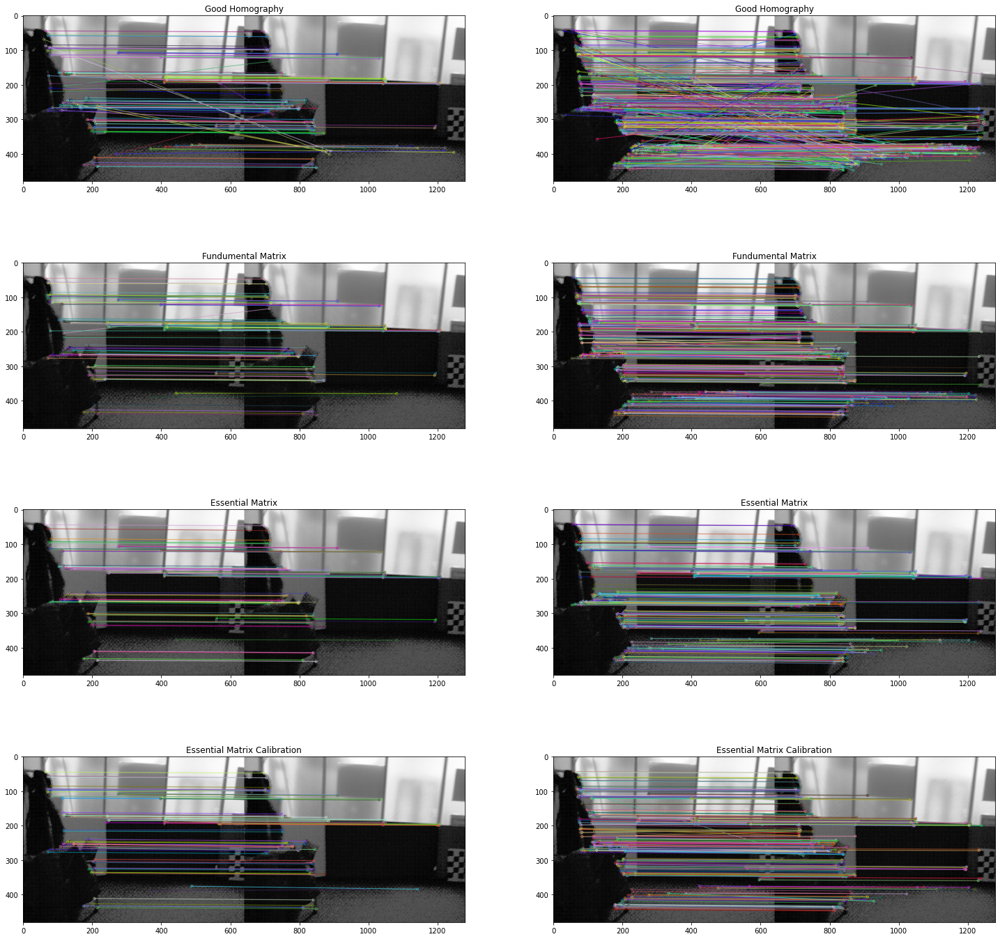

------------------------------------------------------------------------------------------------------------------------------------------------------------------


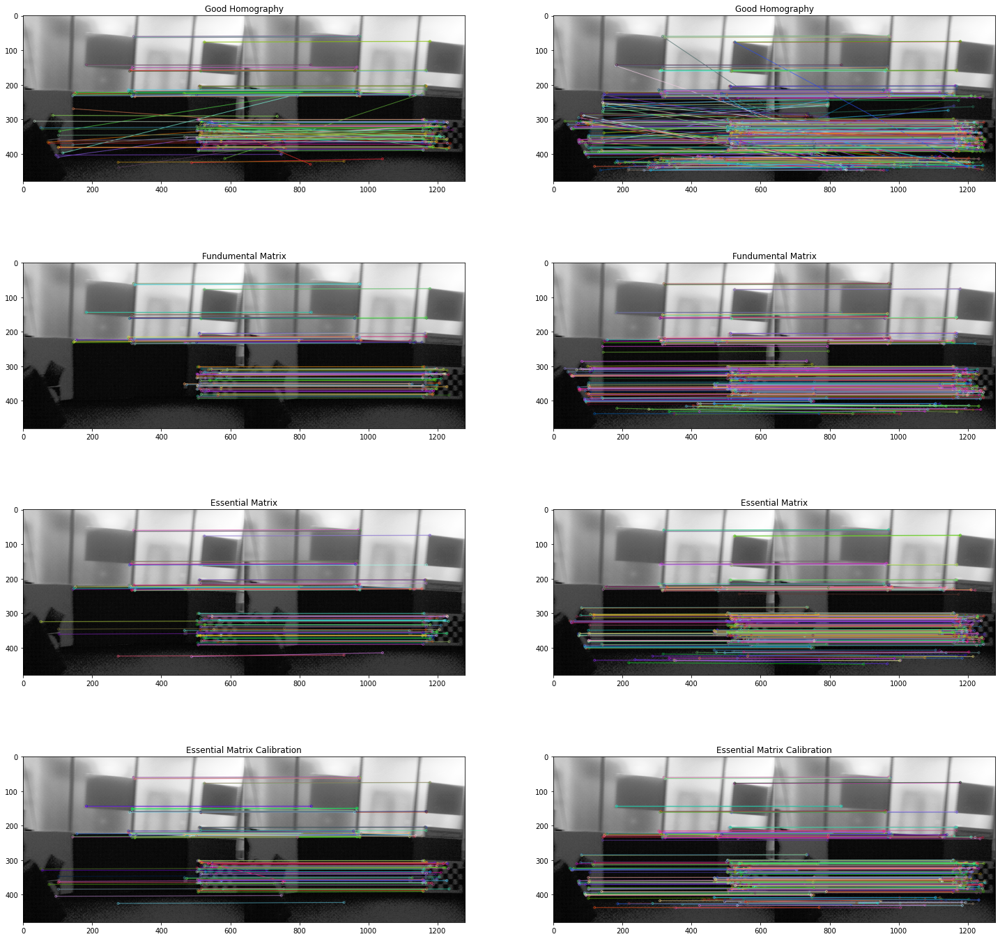

------------------------------------------------------------------------------------------------------------------------------------------------------------------


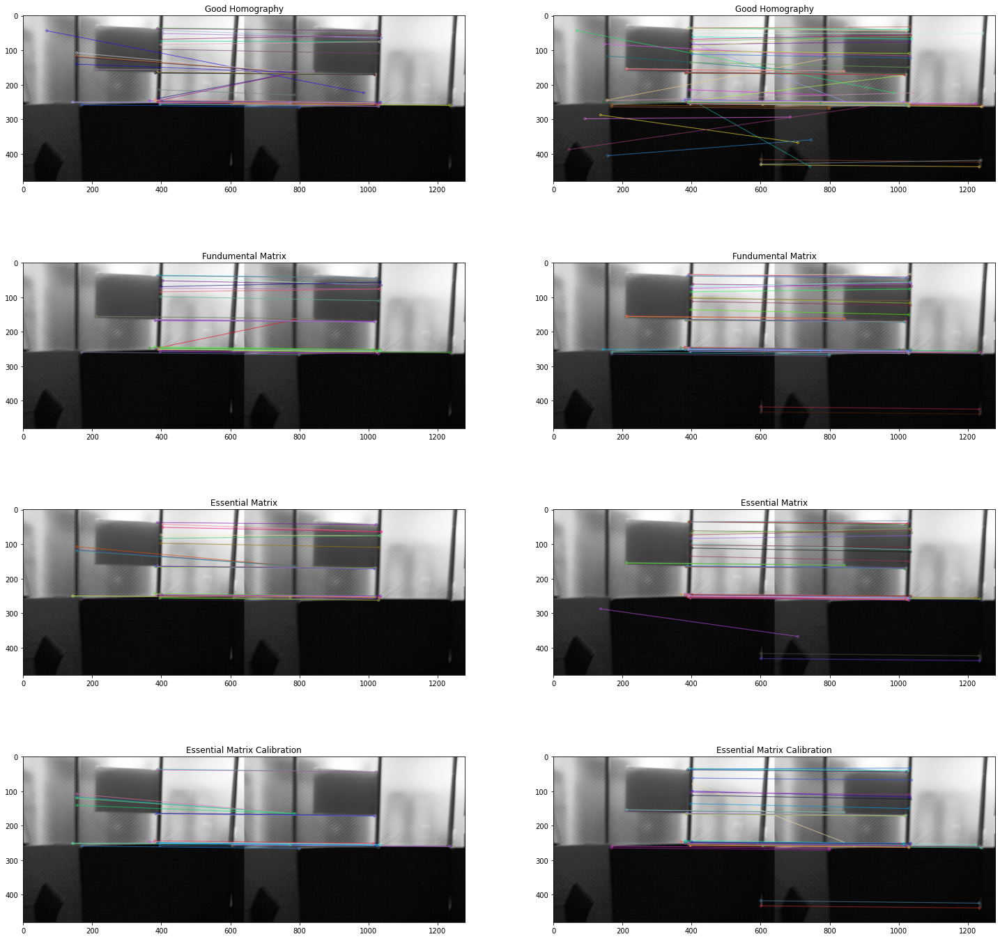

------------------------------------------------------------------------------------------------------------------------------------------------------------------


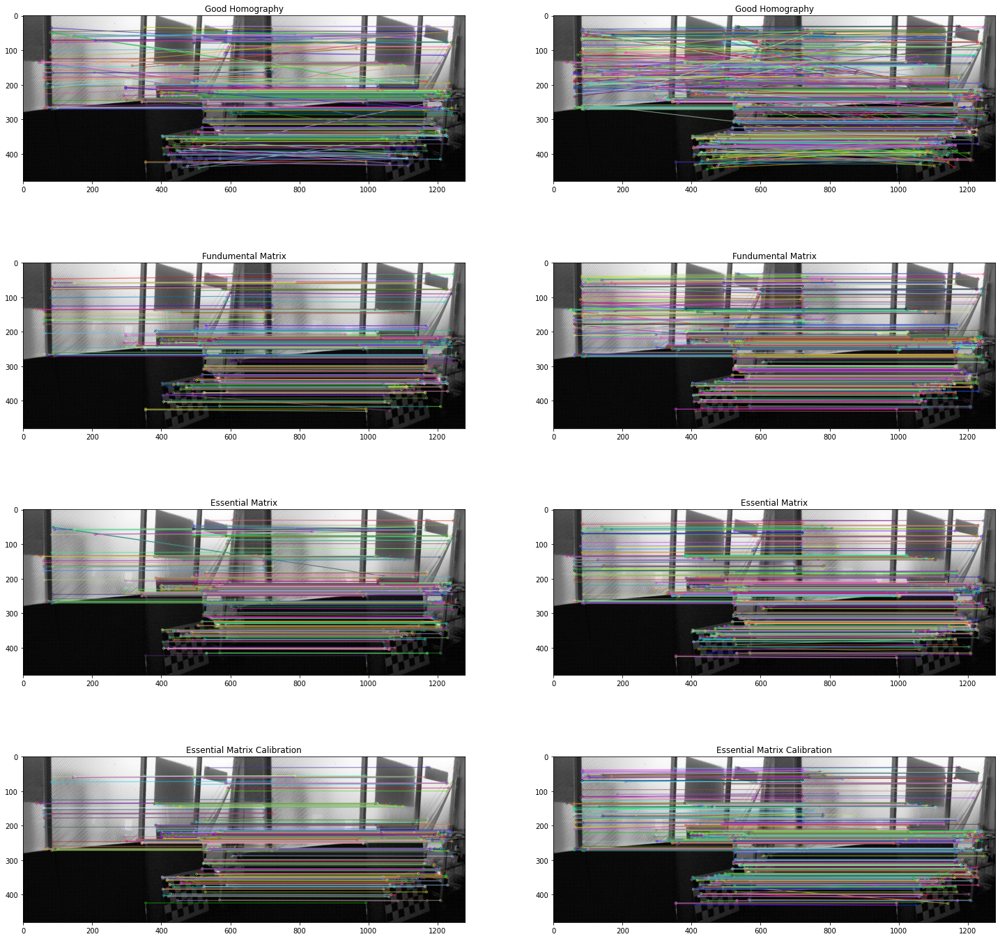

------------------------------------------------------------------------------------------------------------------------------------------------------------------


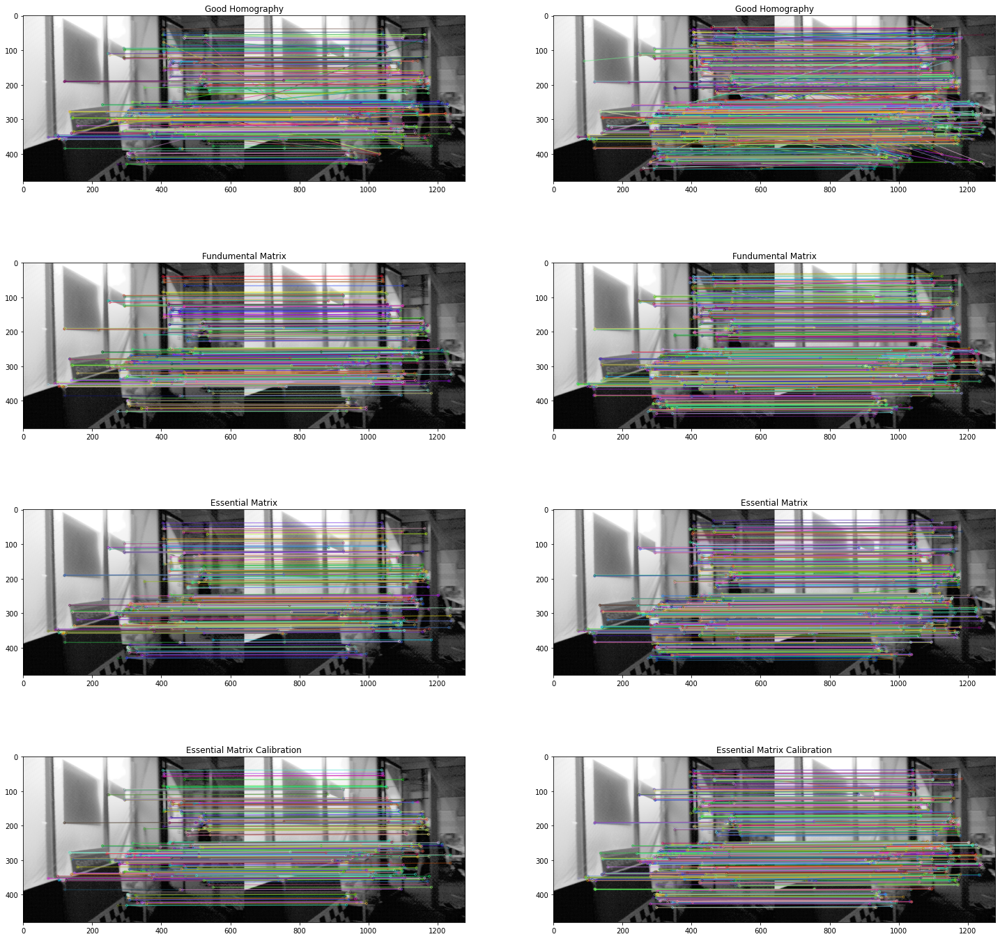

------------------------------------------------------------------------------------------------------------------------------------------------------------------


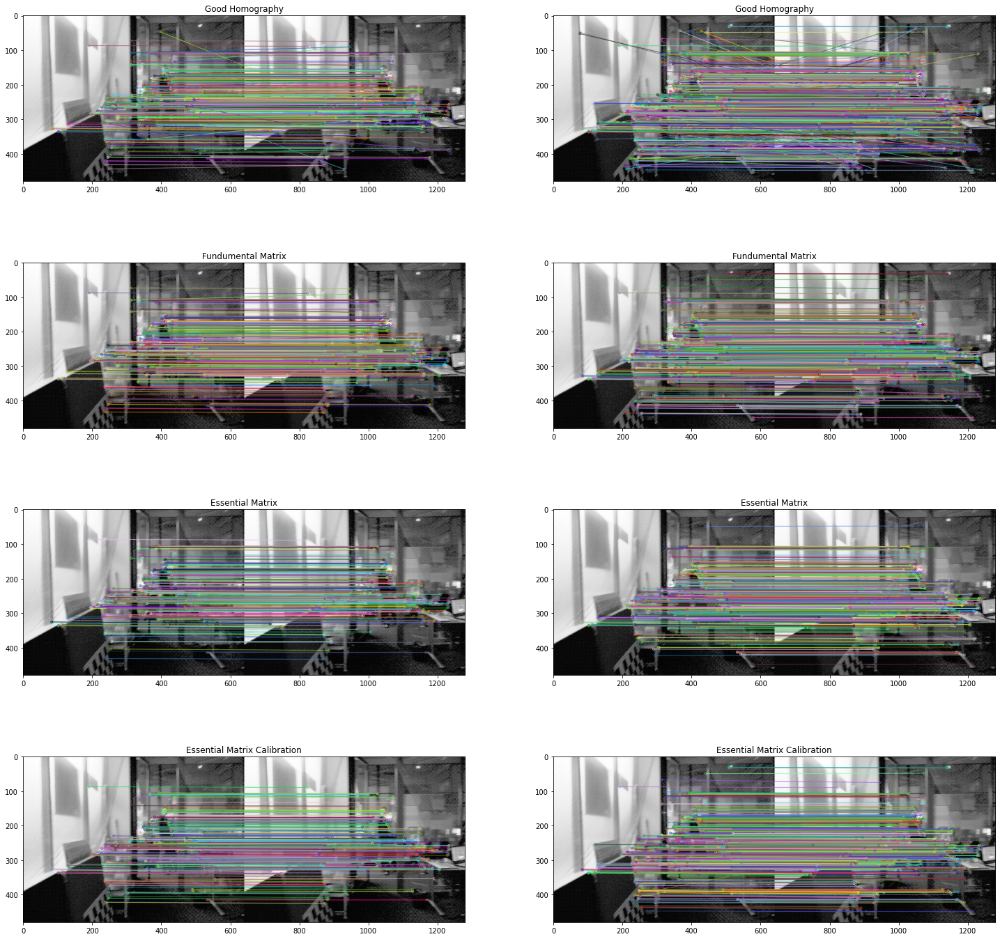

------------------------------------------------------------------------------------------------------------------------------------------------------------------


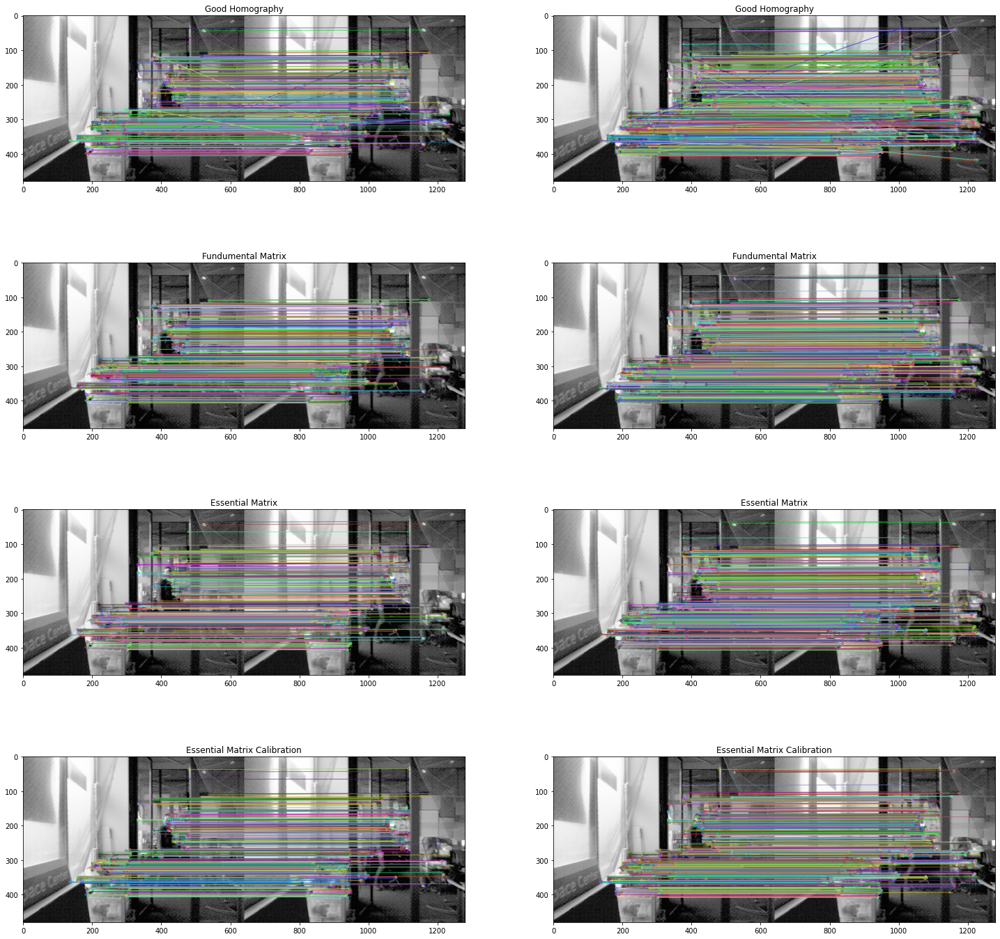

------------------------------------------------------------------------------------------------------------------------------------------------------------------


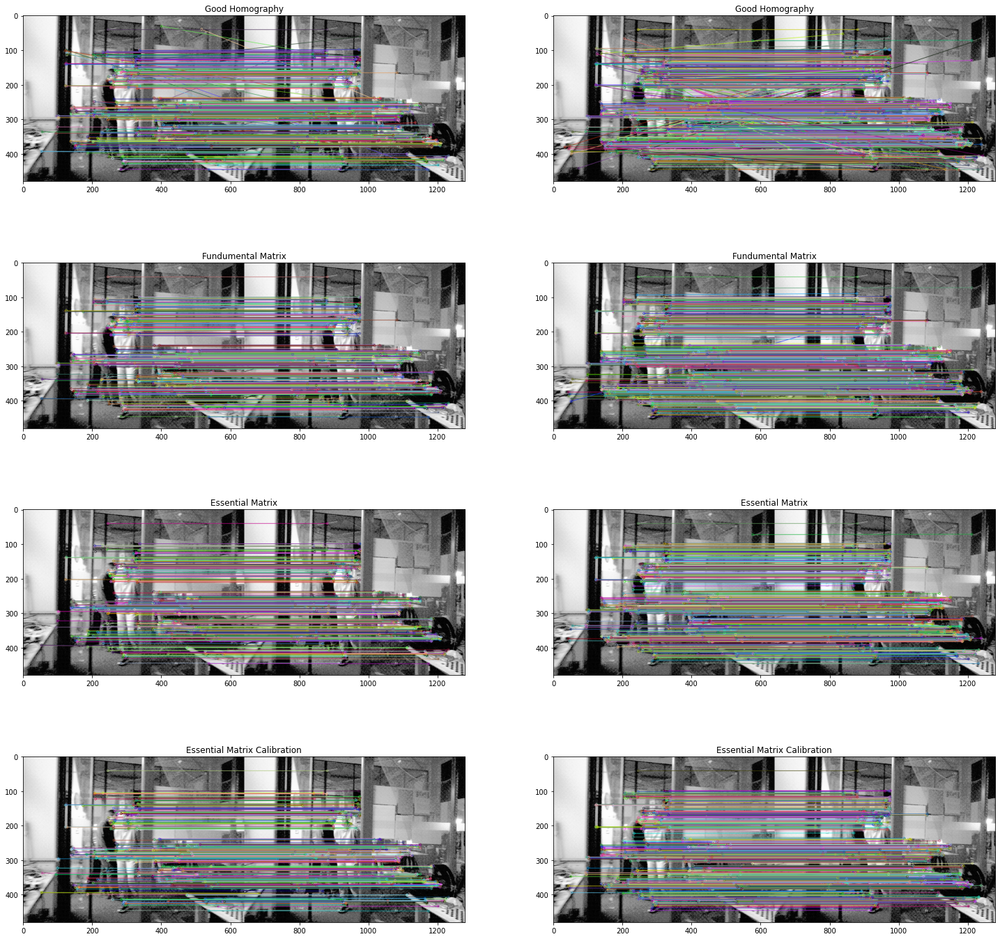

------------------------------------------------------------------------------------------------------------------------------------------------------------------


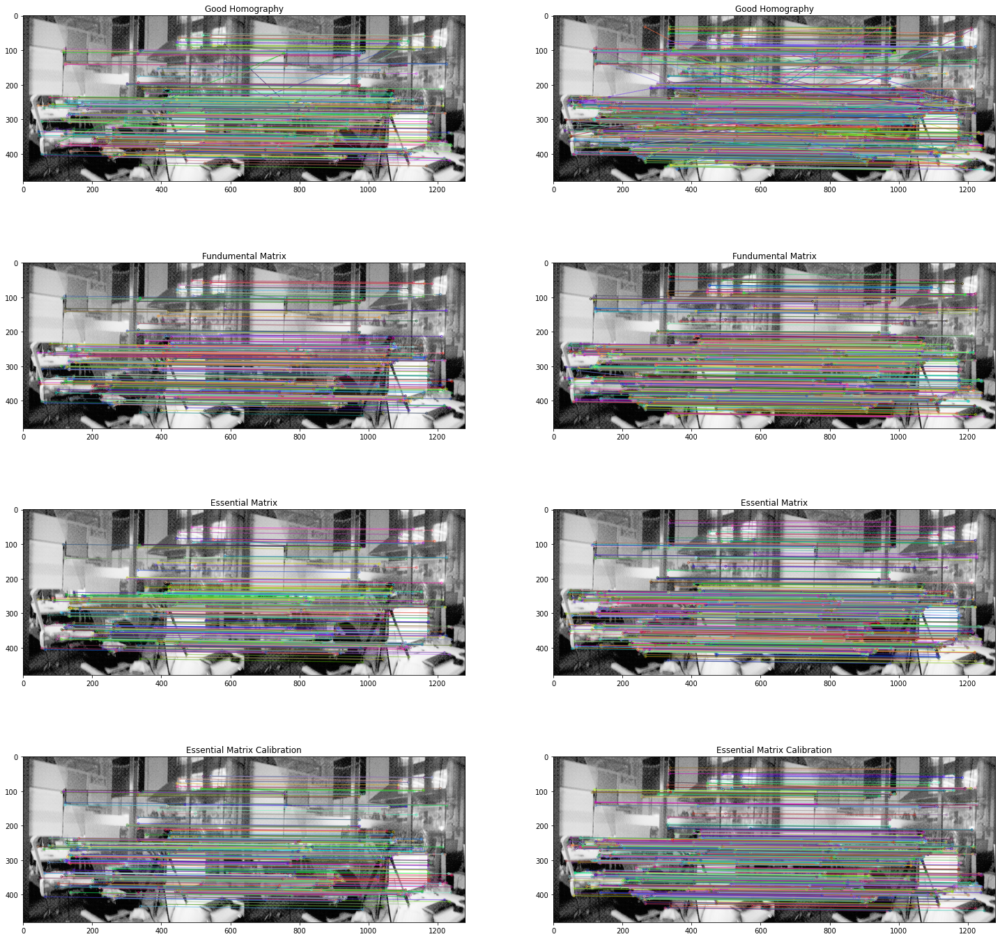

------------------------------------------------------------------------------------------------------------------------------------------------------------------


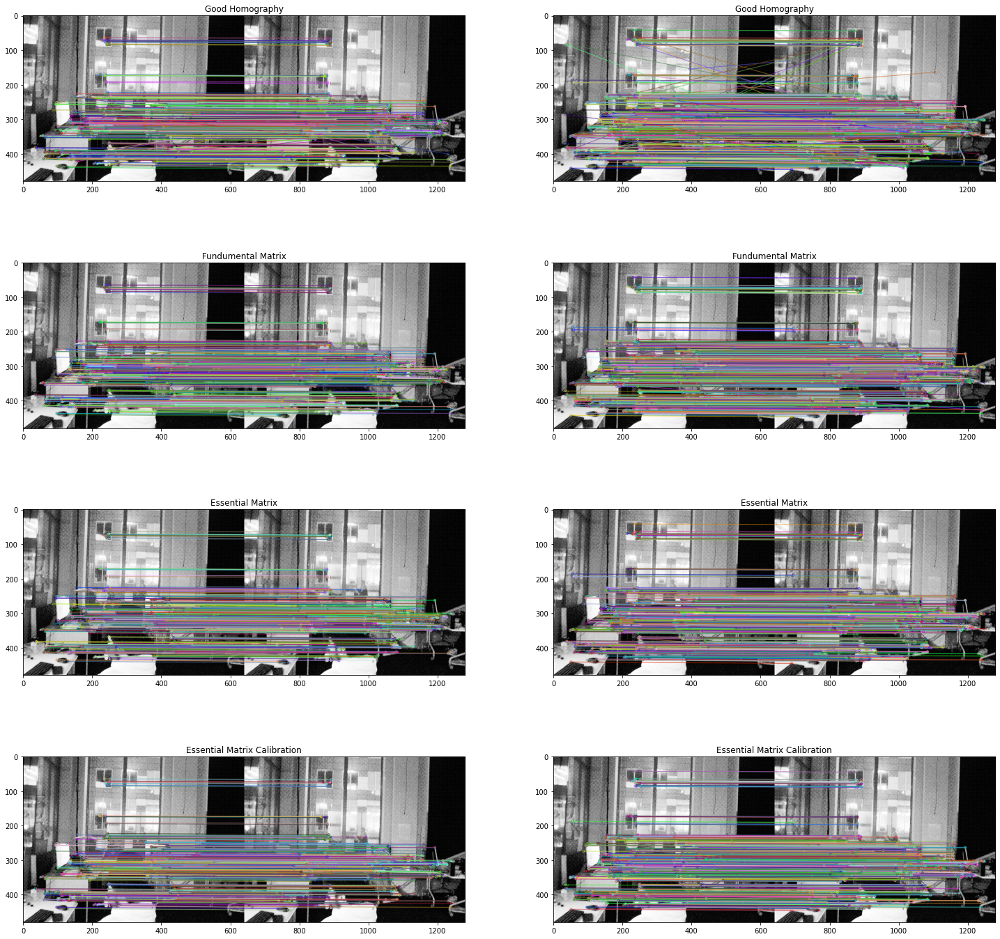

------------------------------------------------------------------------------------------------------------------------------------------------------------------


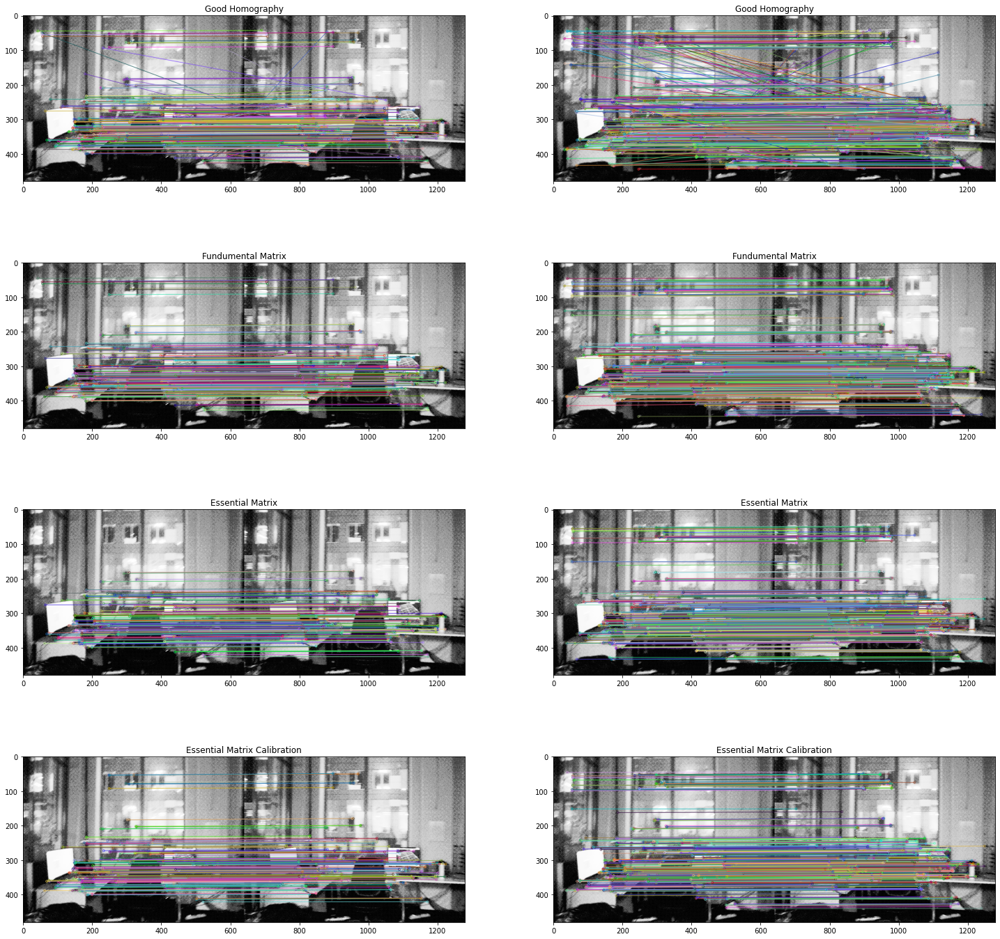

------------------------------------------------------------------------------------------------------------------------------------------------------------------


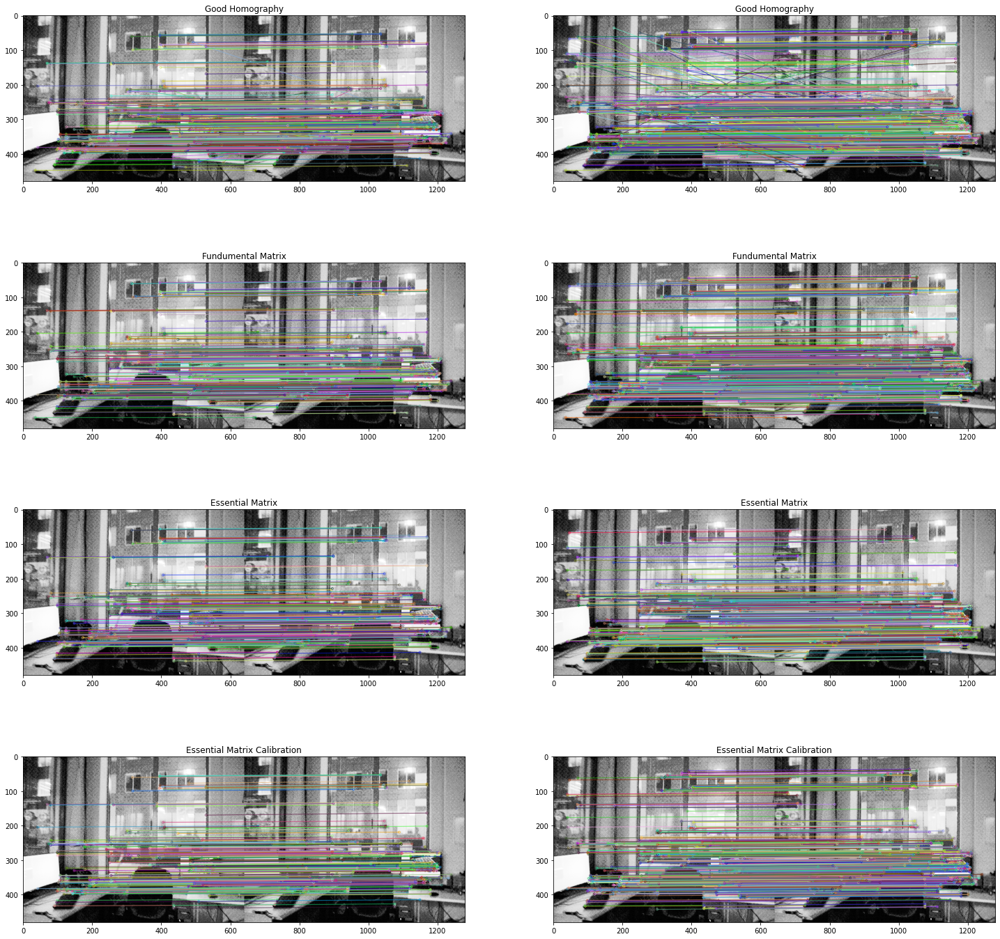

------------------------------------------------------------------------------------------------------------------------------------------------------------------


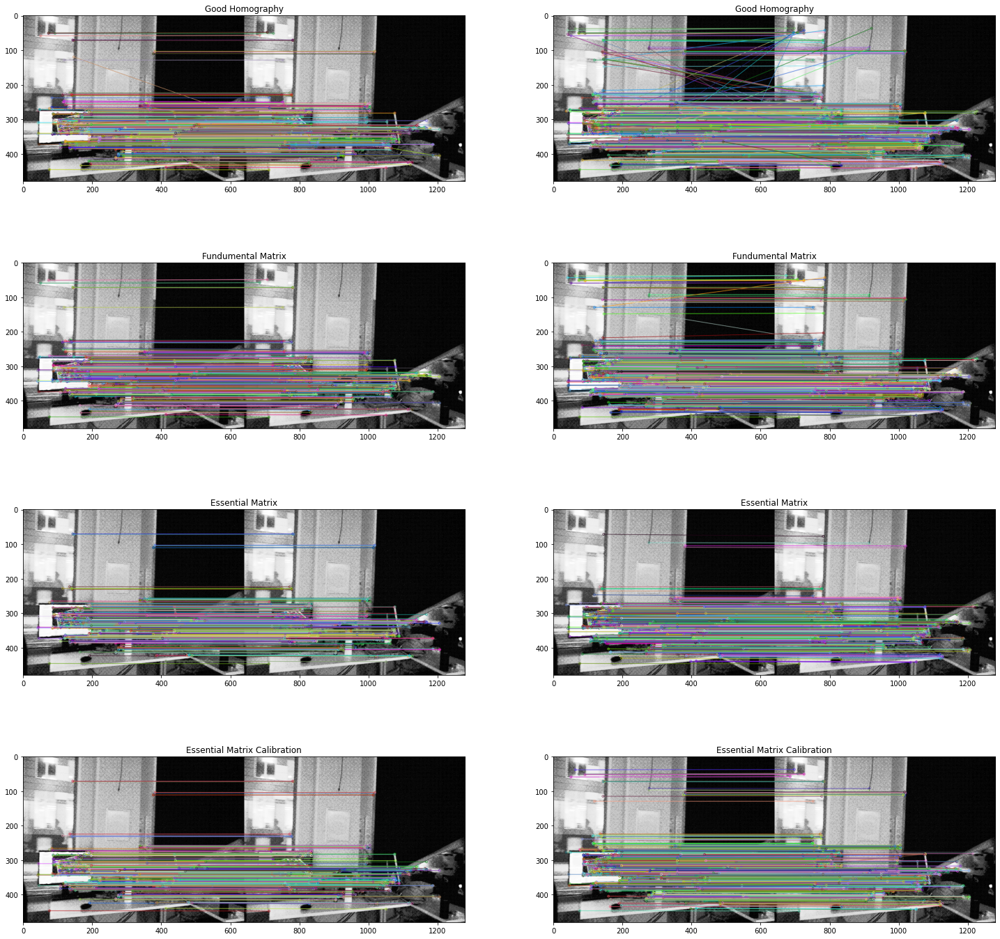

------------------------------------------------------------------------------------------------------------------------------------------------------------------


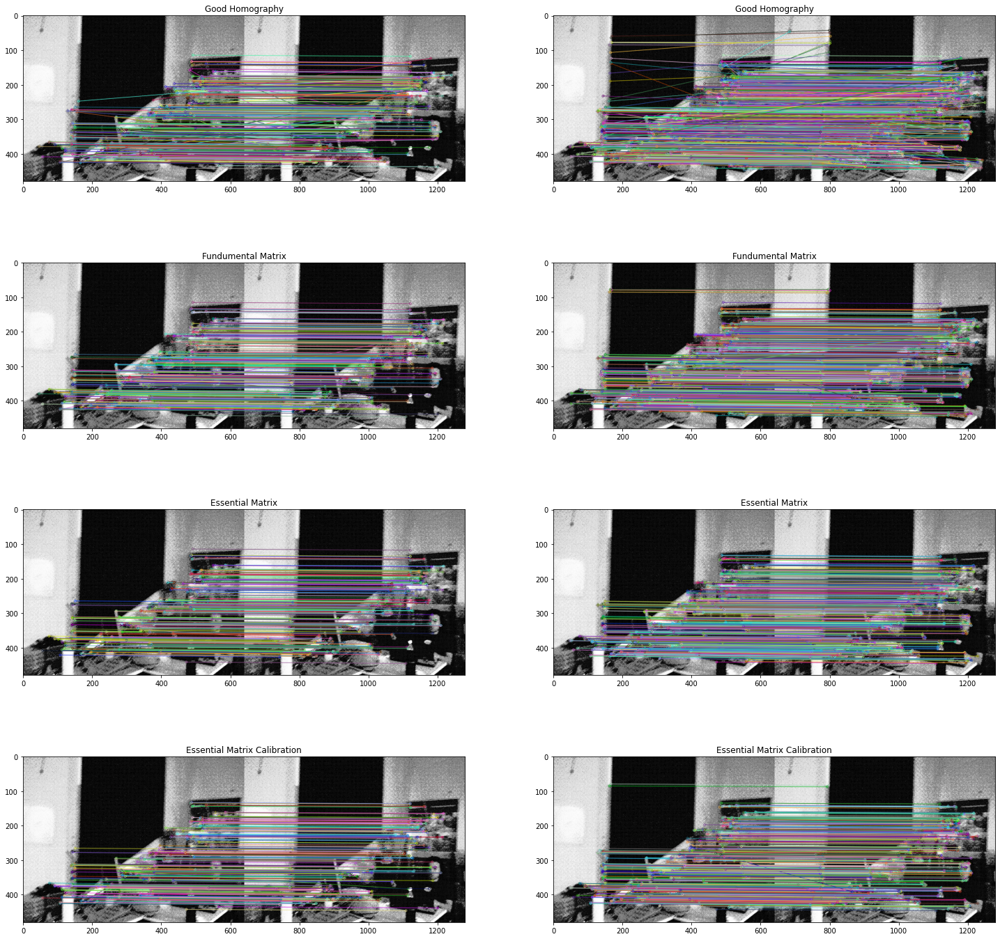

------------------------------------------------------------------------------------------------------------------------------------------------------------------


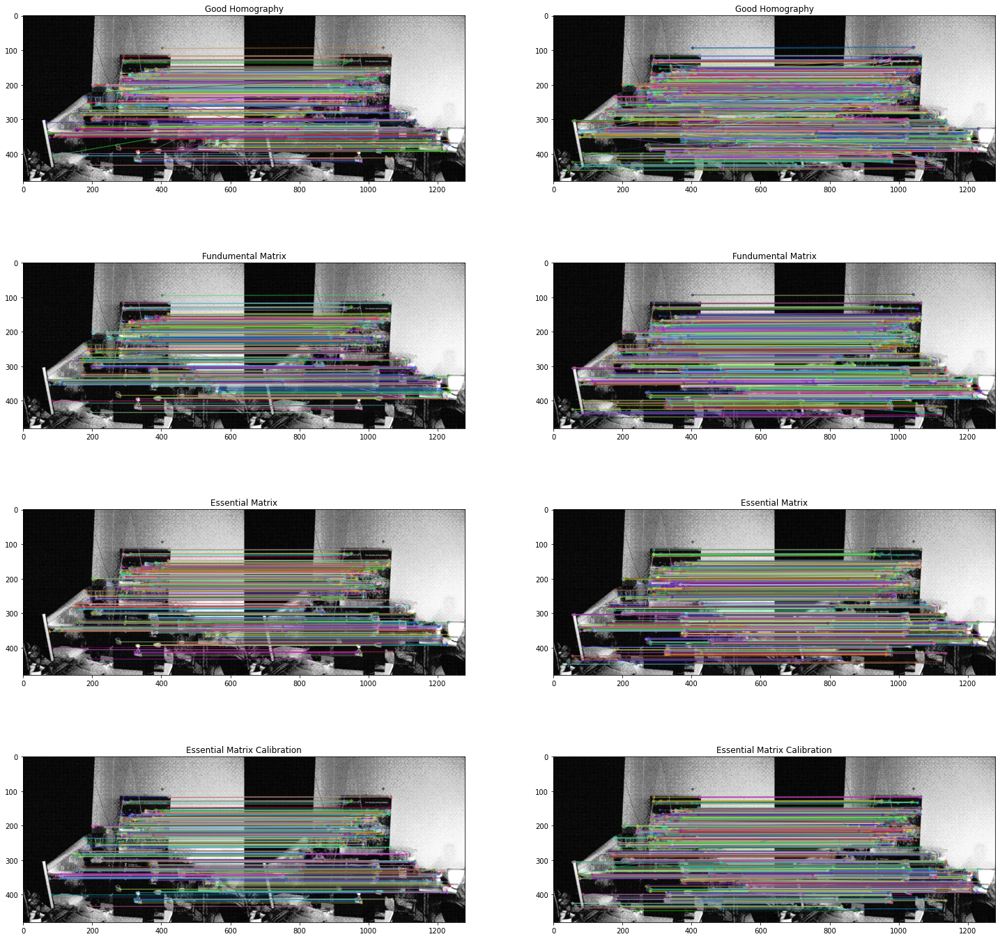

------------------------------------------------------------------------------------------------------------------------------------------------------------------


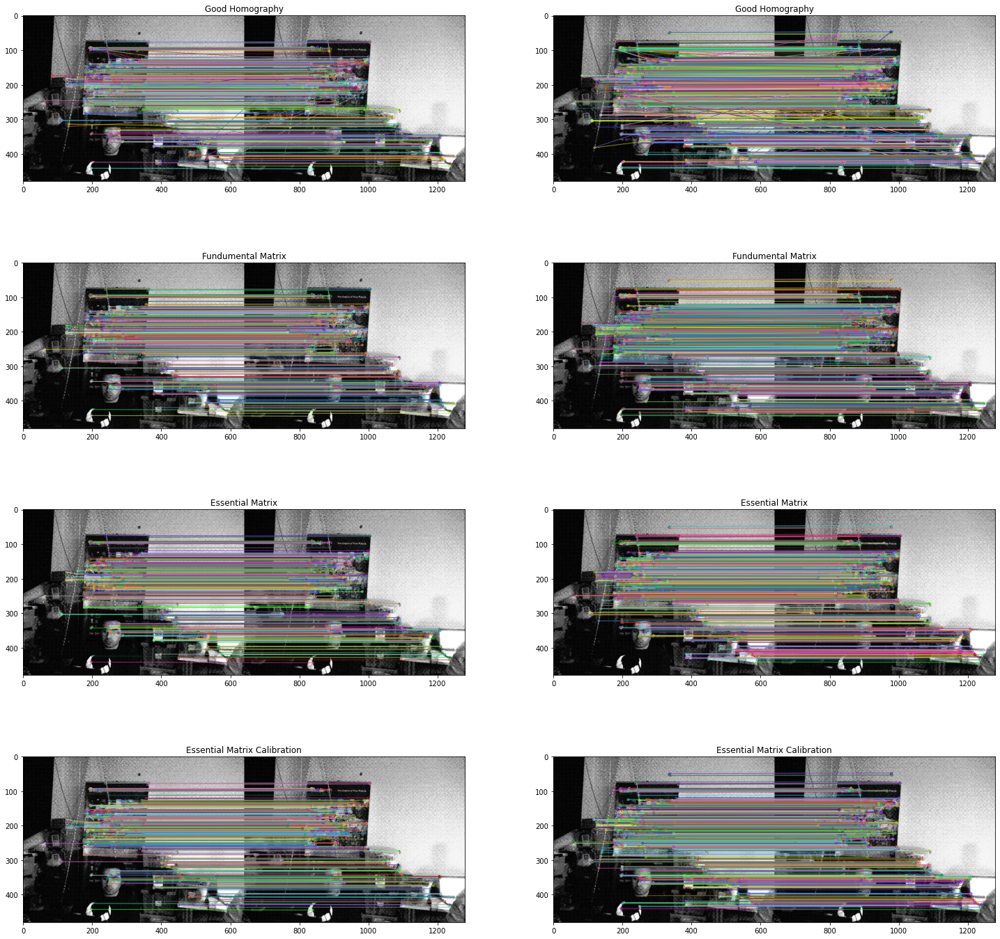

------------------------------------------------------------------------------------------------------------------------------------------------------------------


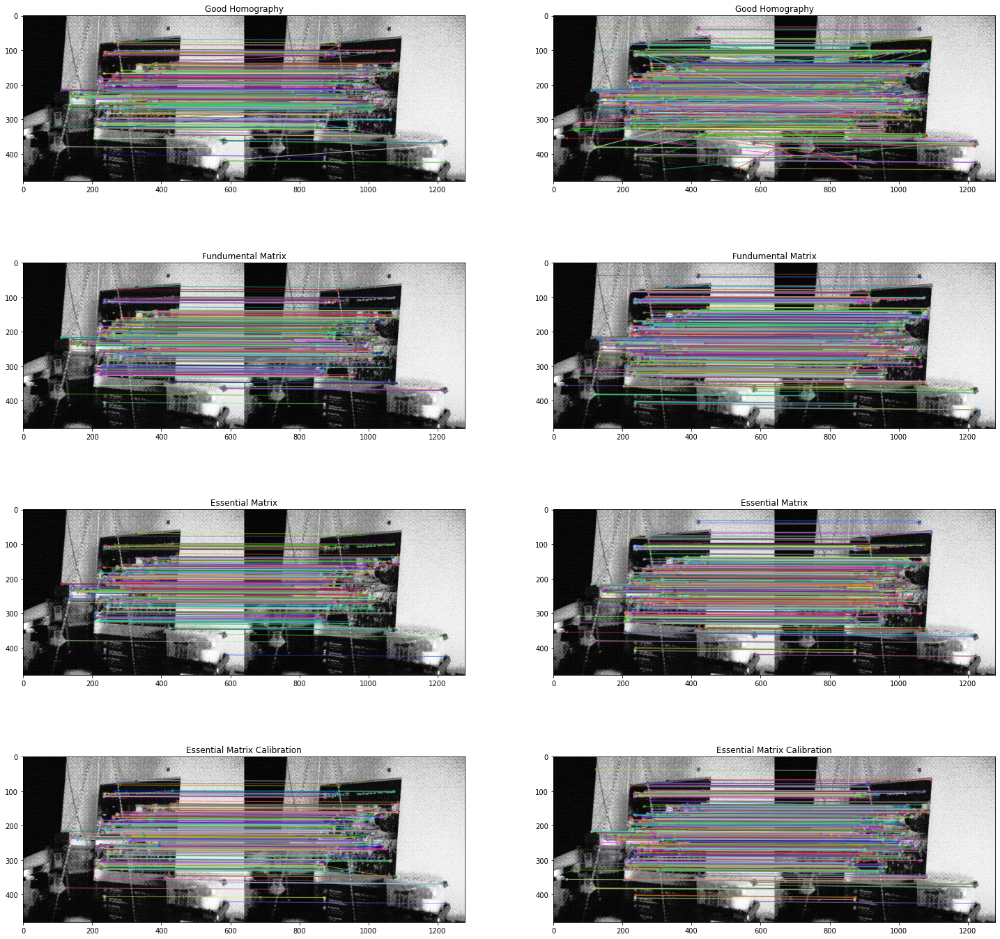

------------------------------------------------------------------------------------------------------------------------------------------------------------------


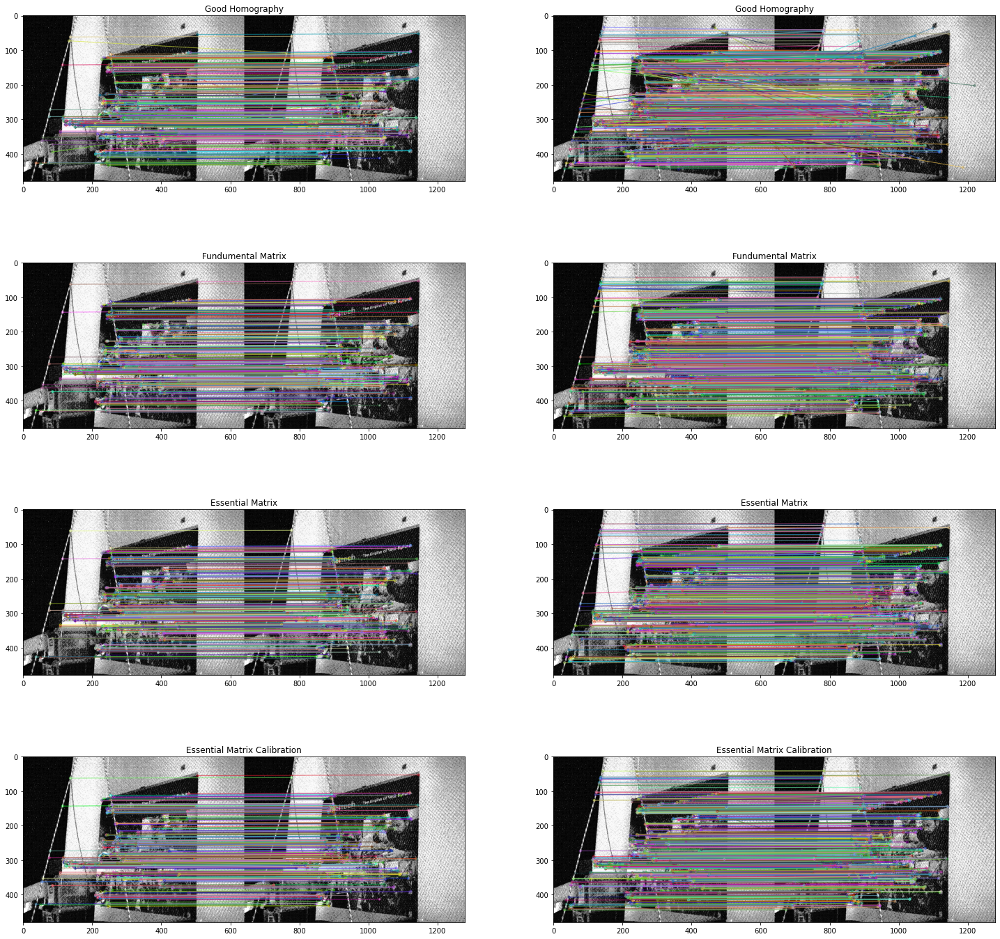

------------------------------------------------------------------------------------------------------------------------------------------------------------------


In [79]:
dataset = "/home/alena/Documents/dark-slam/datasets/original/images/hist/2021-11-24-21-10-35/"


for i in range(0, 880, 50):
    
    img1 = cv2.imread(dataset + "%06i.png"%i, 0)
    img2 = cv2.imread(dataset + "%06i.png"%(i+1), 0)
    
    
    orb_img1, kp1, des1 = orb_feature_exctraction(img1)
    orb_img2, kp2, des2 = orb_feature_exctraction(img2)
    
    ####### BF MATCHER
    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches_bf  = bf.match(des1, des2)

    good_bf = []
    for m in matches_bf:
        good_bf.append([m])

    ##### KNN BF MATCHER
    bf = cv2.BFMatcher()
    matches_knn = bf.knnMatch(des1, des2,k=2)
    # Apply ratio test
    good_knn = []
    for m,n in matches_knn:
        if m.distance < 0.8*n.distance:
            good_knn.append([m])

#     ### PLOT RESULTS
#     fig, ax = plt.subplots(figsize=(20, 20), nrows=2)
#     # BF matcher
#     img_bf = cv2.drawMatchesKnn(img1,kp1,img2,kp2,good_bf,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
#     ax[0].set_title("BF Matcher")
#     ax[0].imshow(img_bf)

#     # BF-KNN matcher
#     img_knn = cv2.drawMatchesKnn(img1,kp1,img2,kp2,good_knn,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
#     ax[1].set_title("BF, knn-matcher + Lowe Ratio")
#     ax[1].imshow(img_knn)
    
    
    good_homography_knn = get_good_matches(good_knn, kp1, kp2, method="homo")
    good_fm_knn = get_good_matches(good_knn, kp1, kp2, method="fm")
    good_em_knn = get_good_matches(good_knn, kp1, kp2, method="em")
    good_em_calib_knn = get_good_matches(good_knn, kp1, kp2, method="em_calib")

    good_homography_bf = get_good_matches(good_bf, kp1, kp2, method="homo")
    good_fm_bf = get_good_matches(good_bf, kp1, kp2, method="fm")
    good_em_bf = get_good_matches(good_bf, kp1, kp2, method="em")
    good_em_calib_bf = get_good_matches(good_bf, kp1, kp2, method="em_calib")

    fig, ax = plt.subplots(figsize=(25,25), nrows=4, ncols=2)

    i=0
    # Homography
    img_homo = cv2.drawMatchesKnn(img1, kp1, img2, kp2, good_homography_knn, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    ax[0, i].set_title("Good Homography")
    ax[0, i].imshow(img_homo)

    # EM
    img_em = cv2.drawMatchesKnn(img1, kp1, img2, kp2, good_fm_knn, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    ax[1, i].set_title("Fundumental Matrix")
    ax[1, i].imshow(img_em)

    # FM
    img_em = cv2.drawMatchesKnn(img1, kp1, img2, kp2, good_em_knn, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    ax[2, i].set_title("Essential Matrix")
    ax[2, i].imshow(img_em)

    # EM w/ot calibration
    img_fm = cv2.drawMatchesKnn(img1, kp1, img2, kp2, good_em_calib_knn, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    ax[3, i].set_title("Essential Matrix Calibration")
    ax[3, i].imshow(img_fm)


    i=1
    # Homography
    img_homo = cv2.drawMatchesKnn(img1, kp1, img2, kp2, good_homography_bf, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    ax[0, i].set_title("Good Homography")
    ax[0, i].imshow(img_homo)

    # EM
    img_em = cv2.drawMatchesKnn(img1, kp1, img2, kp2, good_fm_bf, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    ax[1, i].set_title("Fundumental Matrix")
    ax[1, i].imshow(img_em)

    # FM
    img_em = cv2.drawMatchesKnn(img1, kp1, img2, kp2, good_em_bf, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    ax[2, i].set_title("Essential Matrix")
    ax[2, i].imshow(img_em)

    # EM w/ot calibration
    img_fm = cv2.drawMatchesKnn(img1, kp1, img2, kp2, good_em_calib_bf, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    ax[3, i].set_title("Essential Matrix Calibration")
    ax[3, i].imshow(img_fm)
    plt.show();
    print("------------------------------------------------------------------------------------------------------------------------------------------------------------------")